In [4]:
import os
import pandas as pd

import scanpy as sc
import liana as li
import matplotlib.pyplot as plt

def load_prep_slide(path, slide, add_sample_name=False, min_genes = 400, bandwidth=150, cutoff=0.1, set_diag=True, **kwargs):
    adata = sc.read_h5ad(os.path.join(path, slide))
    
    if add_sample_name:
        indeces = [f"{slide.split('.')[0]}-{i}" for i in adata.obs.index]
        adata.obs.index = indeces
        adata.obsm['compositions'].index = indeces
    
    sc.pp.filter_cells(adata, min_genes=min_genes)
    sc.pp.filter_genes(adata, min_cells=5)
    
    sc.pp.normalize_total(adata, target_sum=1e4)
    sc.pp.log1p(adata)
    
    li.ut.spatial_neighbors(adata, bandwidth=bandwidth, cutoff=cutoff, set_diag=set_diag, **kwargs)
    
    return adata

In [5]:
os.chdir("/Users/ricardoramirez/Dropbox/PostDoc/Research/Fibrosis_Weizmann/")

In [6]:
data_dir = os.path.join('data', 'visium_data_py')
dataset_names = [f for f in os.listdir(data_dir) if f.endswith('.h5ad')]

In [7]:
metadata = pd.read_csv(os.path.join("data", "visium_meta.csv")).set_index('slide_name')
group_dict = {'group_1': 'Myogenic', 'group_2':'Ischemic', 'group_3': 'Fibrotic'}
#rename_dict = {'Myogenic': 'Myogenic \n (n=14)', 'Ischemic':'Ischemic \n (n=9)', 'Fibrotic': 'Fibrotic \n (n=5)'}
condition_key = 'patient_group'
metadata['patient_group'] = metadata['patient_group'].map(group_dict)

dataset_name: Visium_2_CK280.h5ad; ACH0021
dataset_name: Visium_20_CK298.h5ad; ACH0015


... storing 'ligand' as categorical


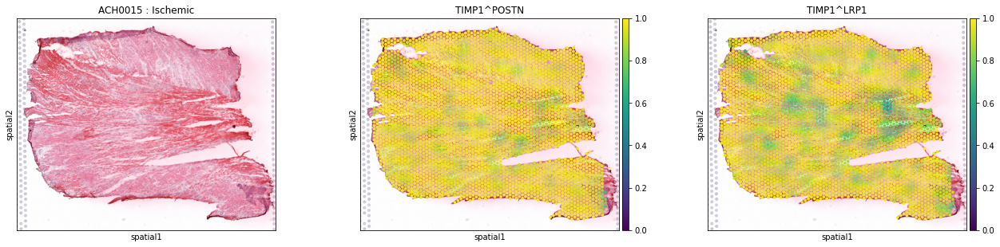

dataset_name: Visium_6_CK284.h5ad; ACH0023


... storing 'ligand' as categorical


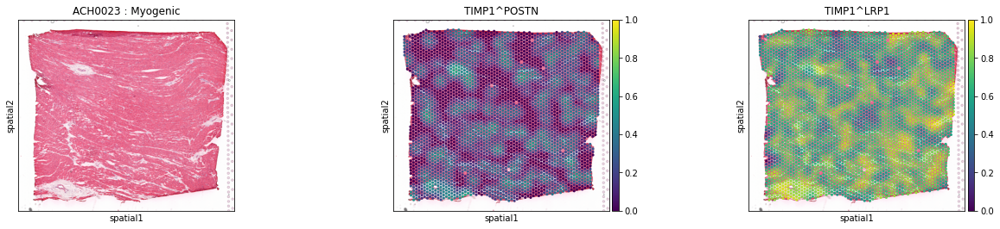

dataset_name: Visium_4_CK282.h5ad; ACH004


... storing 'ligand' as categorical


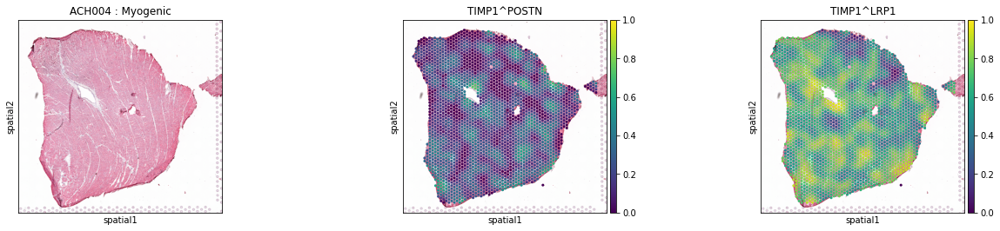

dataset_name: Visium_19_CK297.h5ad; ACH0013


... storing 'ligand' as categorical


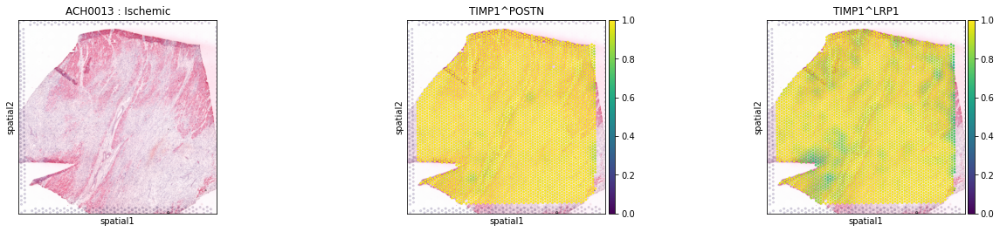

dataset_name: Visium_13_CK291.h5ad; ACH006


... storing 'ligand' as categorical


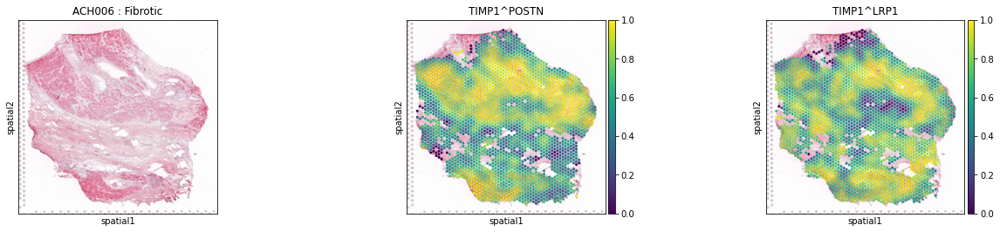

dataset_name: Visium_17_CK295.h5ad; ACH0022
dataset_name: Visium_10_CK288.h5ad; ACH0024


... storing 'ligand' as categorical


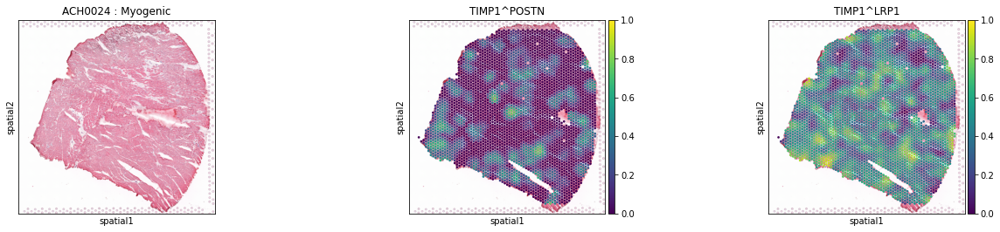

dataset_name: AKK003_157777.h5ad; 10X0025


... storing 'ligand' as categorical


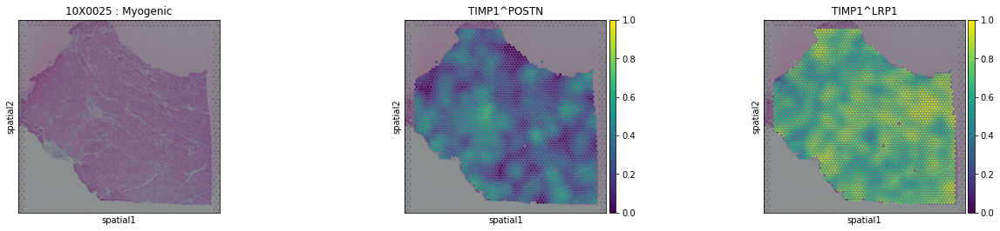

dataset_name: Visium_15_CK293.h5ad; ACH0016


... storing 'ligand' as categorical


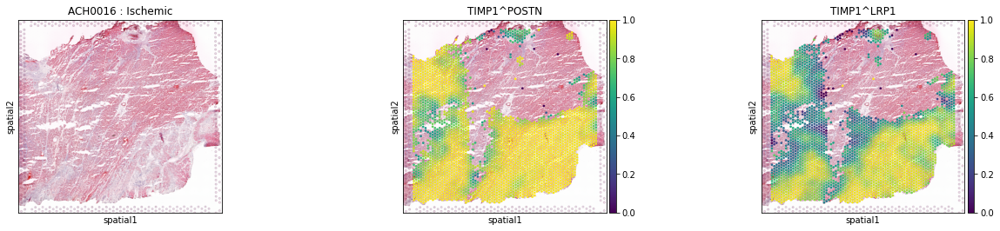

dataset_name: Visium_8_CK286.h5ad; ACH0019


... storing 'ligand' as categorical


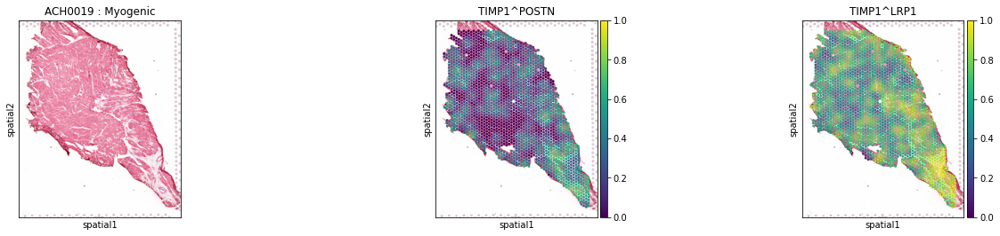

dataset_name: AKK002_157779.h5ad; 10X0017


... storing 'ligand' as categorical


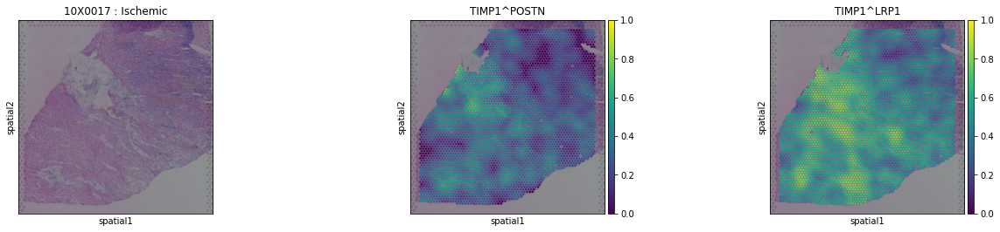

dataset_name: AKK006_157771.h5ad; 10X001


... storing 'ligand' as categorical


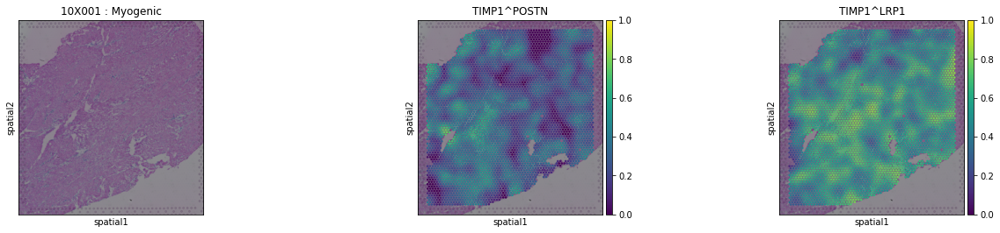

dataset_name: AKK002_157781.h5ad; 10X0026


... storing 'ligand' as categorical


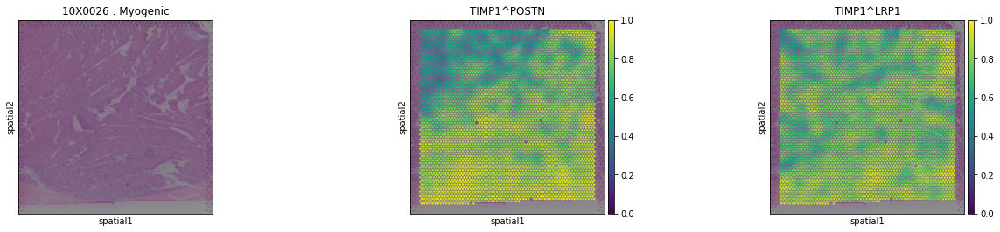

dataset_name: AKK004_157772.h5ad; 10X009


... storing 'ligand' as categorical


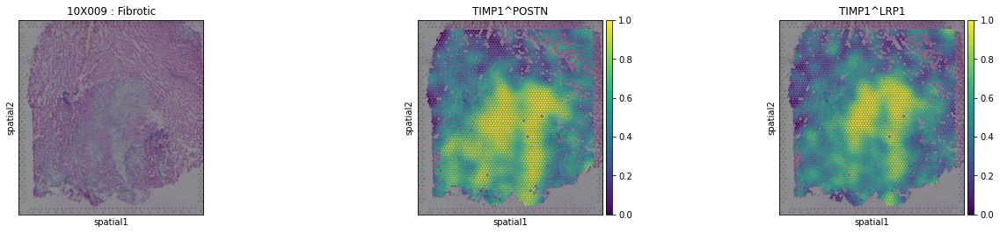

dataset_name: AKK002_157782.h5ad; 10X0020


... storing 'ligand' as categorical


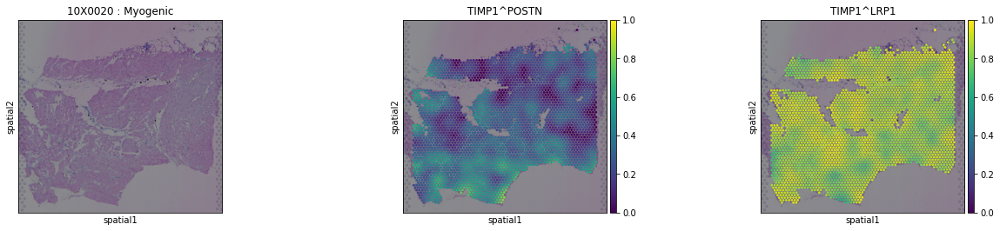

dataset_name: Visium_18_CK296.h5ad; ACH0011


... storing 'ligand' as categorical


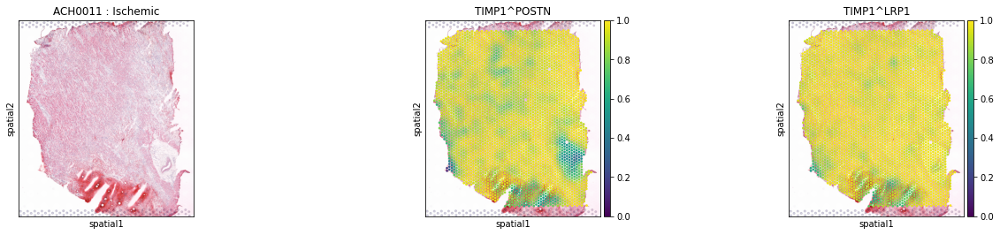

dataset_name: Visium_5_CK283.h5ad; ACH0028


... storing 'ligand' as categorical


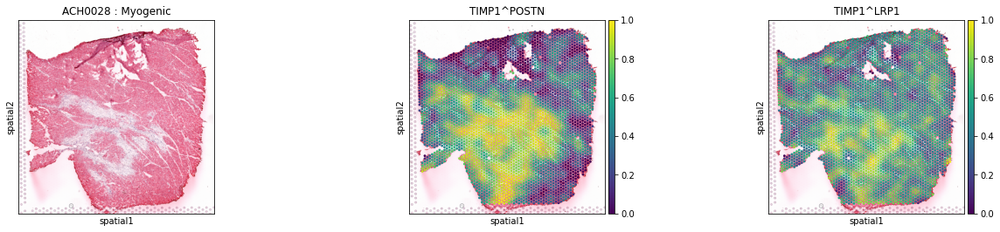

dataset_name: Visium_7_CK285.h5ad; ACH0014


... storing 'ligand' as categorical


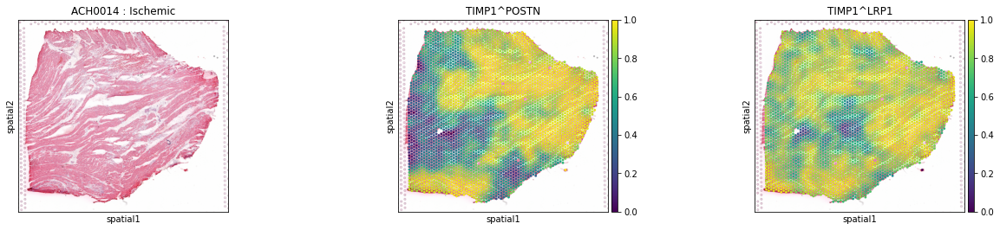

dataset_name: AKK001_157785.h5ad; 10X0027


... storing 'ligand' as categorical


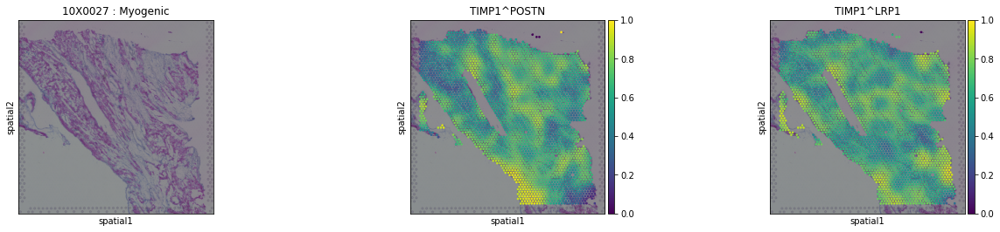

dataset_name: Visium_3_CK281.h5ad; ACH003


... storing 'ligand' as categorical


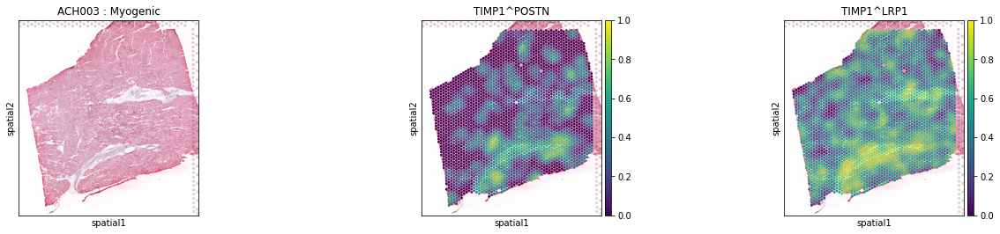

dataset_name: Visium_9_CK287.h5ad; ACH0012


... storing 'ligand' as categorical


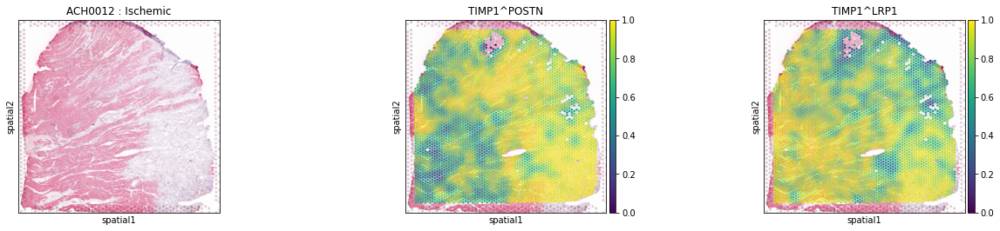

dataset_name: Visium_14_CK292.h5ad; ACH008


... storing 'ligand' as categorical


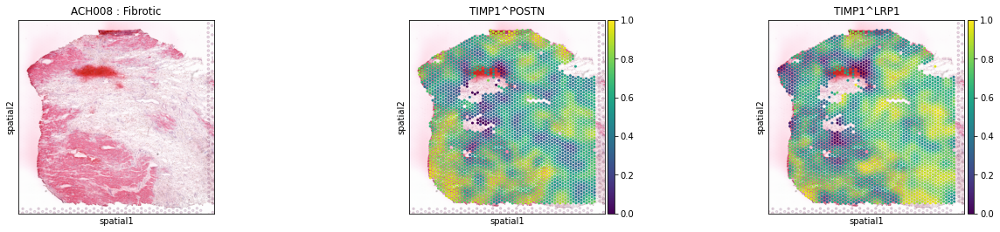

dataset_name: Visium_16_CK294.h5ad; ACH007


... storing 'ligand' as categorical


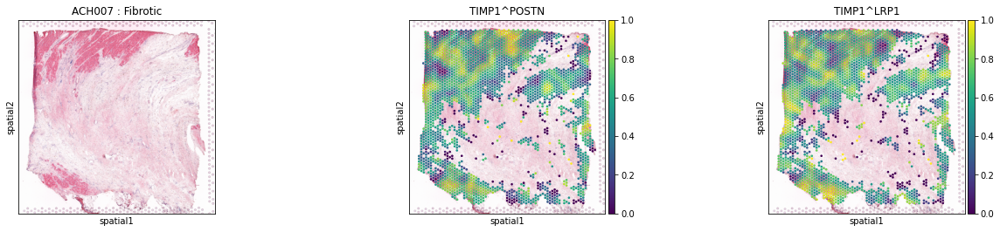

dataset_name: Visium_11_CK289.h5ad; ACH0010


... storing 'ligand' as categorical


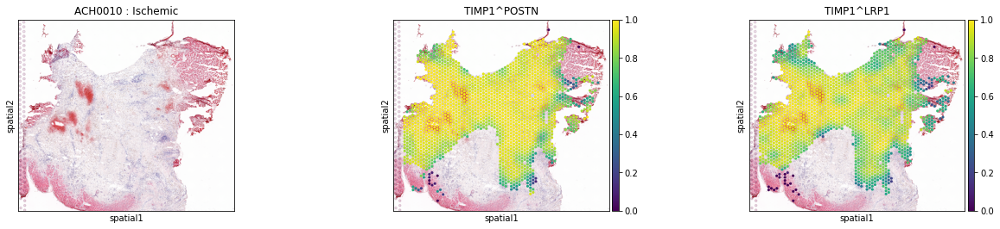

dataset_name: Visium_12_CK290.h5ad; ACH005


... storing 'ligand' as categorical


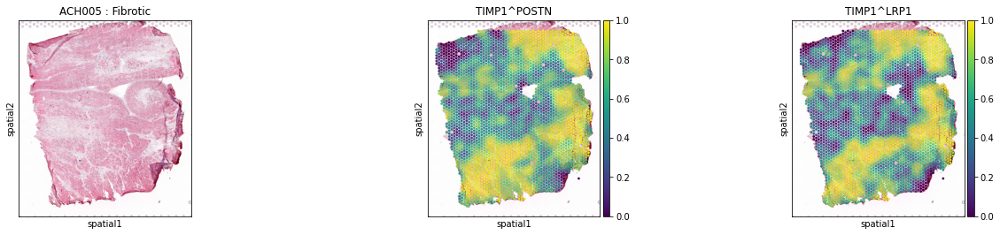

dataset_name: AKK003_157775.h5ad; 10X0018


... storing 'ligand' as categorical


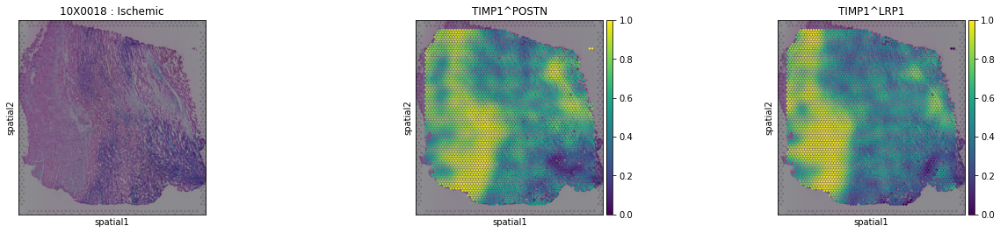

dataset_name: Visium_1_CK279.h5ad; ACH002


... storing 'ligand' as categorical


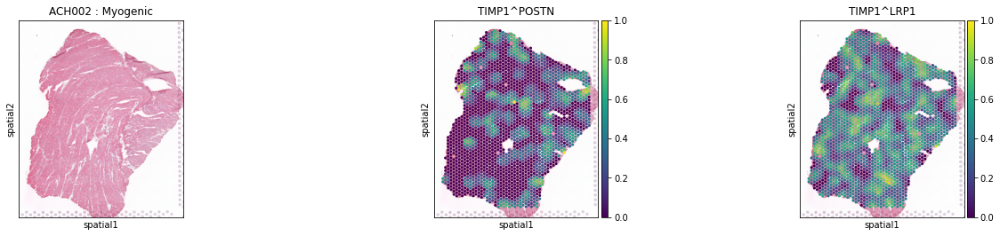

In [32]:
lrdatas = {}
global_scores = {} 

for dataset_name in dataset_names:
   sample_id = metadata.loc[dataset_name.replace('.h5ad', ''), 'hca_sample_id']
   patient_grup = metadata.loc[dataset_name.replace('.h5ad', ''), 'patient_group']
   
   print(f"dataset_name: {dataset_name}; {sample_id}")
   adata = load_prep_slide(data_dir, dataset_name, add_sample_name=True)

   li.ut.spatial_neighbors(adata, bandwidth=150, set_diag=True, cutoff=0.1)

   li.mt.bivariate(adata,
                  local_name='cosine', # Name of the function
                  global_name="morans",
                  nz_prop=0.05,
                  n_perms=None,
                  use_raw=False,
                  add_categories=False,
                  interactions=[('TIMP1', 'POSTN'), ('TIMP1', 'LRP1')]
                  )
   
   lrdata = adata.obsm['local_scores']
   #global_scores = adata.obsm['global_scores']
   if 'TIMP1^POSTN' in lrdata.var.index:
      if 'TIMP1^LRP1' in lrdata.var.index:
         sc.pl.spatial(lrdata, color=[None, 'TIMP1^POSTN', 'TIMP1^LRP1'], 
                       cmap='viridis', size=1.3, 
                       title=f"{sample_id} : {patient_grup}", 
                       save=f"{sample_id}.pdf",
                       vmin = 0, vmax = 1)

   lrdatas[sample_id] = lrdata

dataset_name: Visium_2_CK280.h5ad; ACH0021


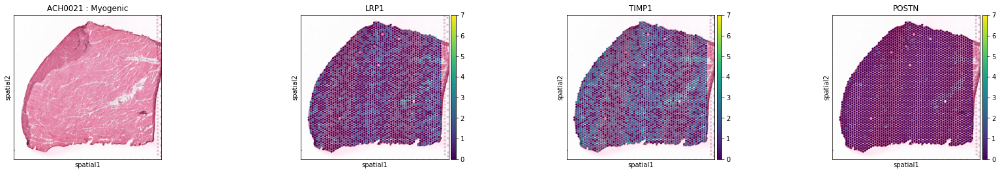

dataset_name: Visium_20_CK298.h5ad; ACH0015


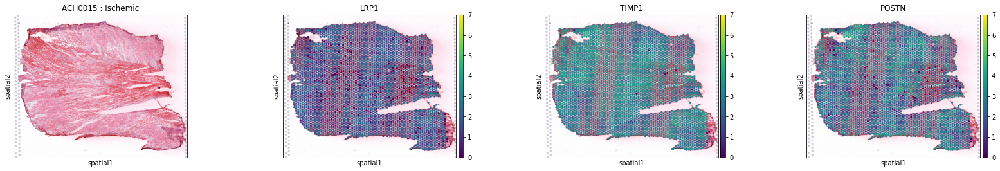

dataset_name: Visium_6_CK284.h5ad; ACH0023


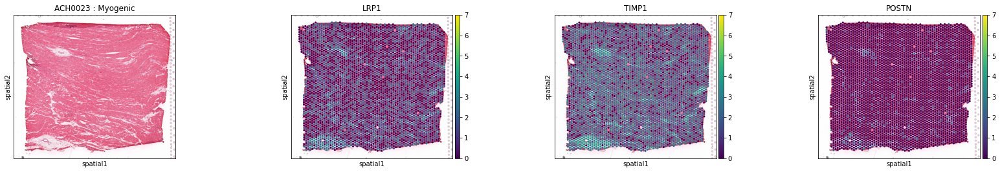

dataset_name: Visium_4_CK282.h5ad; ACH004


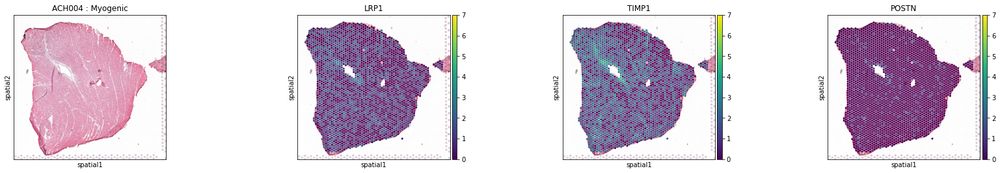

dataset_name: Visium_19_CK297.h5ad; ACH0013


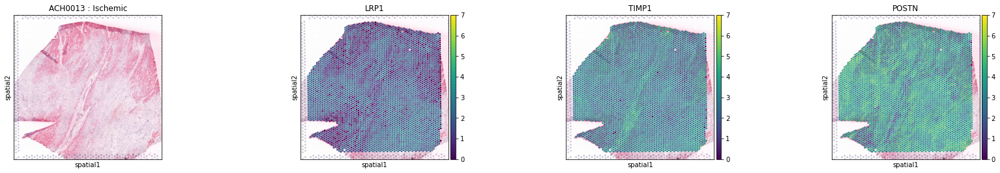

dataset_name: Visium_13_CK291.h5ad; ACH006


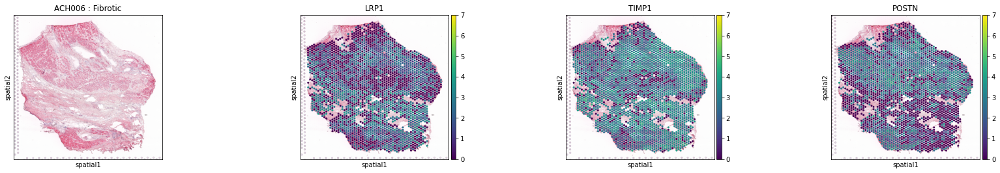

dataset_name: Visium_17_CK295.h5ad; ACH0022


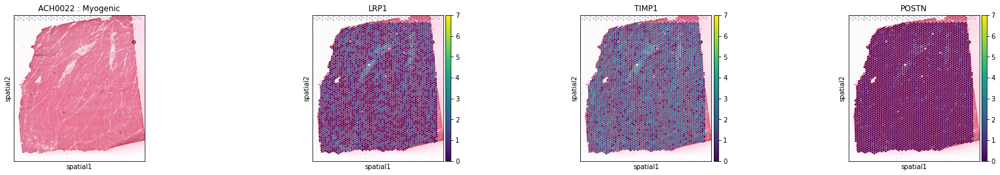

dataset_name: Visium_10_CK288.h5ad; ACH0024


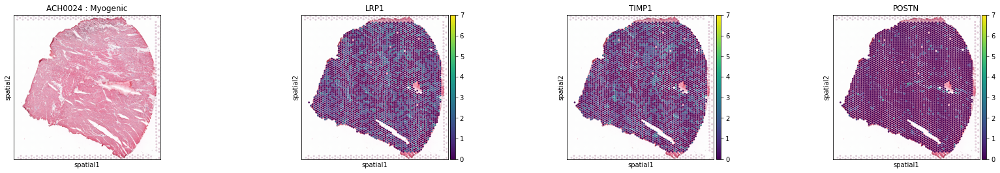

dataset_name: AKK003_157777.h5ad; 10X0025


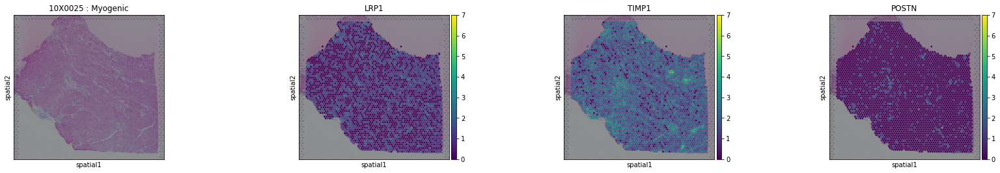

dataset_name: Visium_15_CK293.h5ad; ACH0016


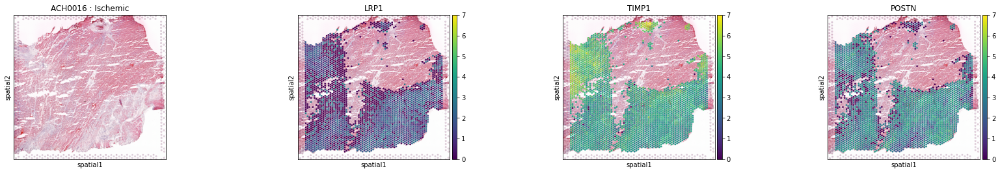

dataset_name: Visium_8_CK286.h5ad; ACH0019


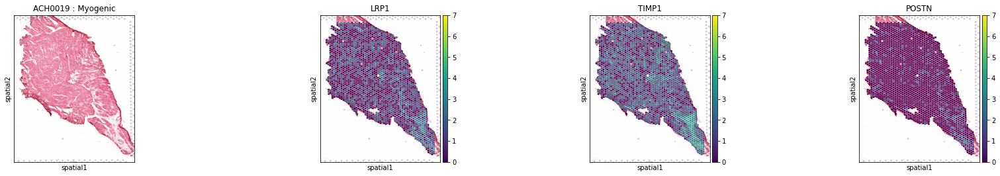

dataset_name: AKK002_157779.h5ad; 10X0017


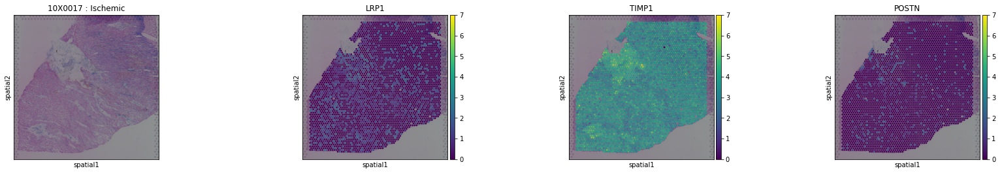

dataset_name: AKK006_157771.h5ad; 10X001


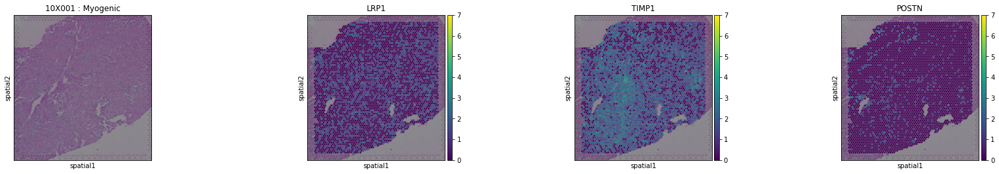

dataset_name: AKK002_157781.h5ad; 10X0026


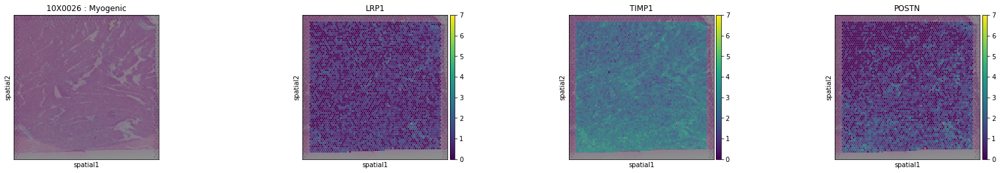

dataset_name: AKK004_157772.h5ad; 10X009


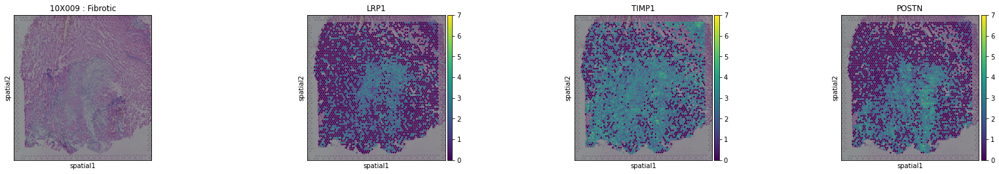

dataset_name: AKK002_157782.h5ad; 10X0020


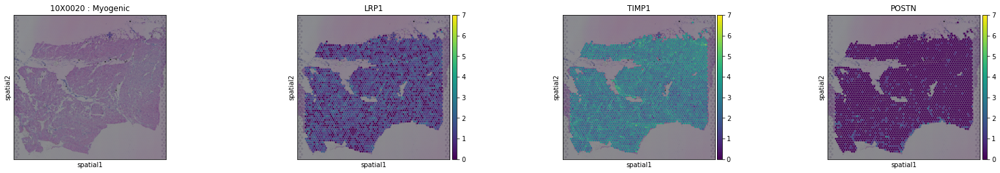

dataset_name: Visium_18_CK296.h5ad; ACH0011


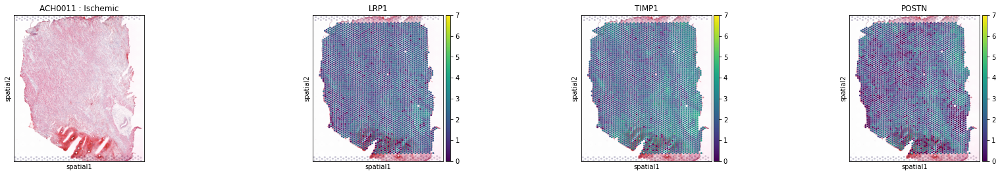

dataset_name: Visium_5_CK283.h5ad; ACH0028


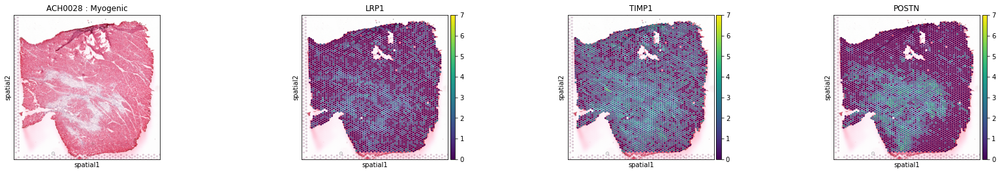

dataset_name: Visium_7_CK285.h5ad; ACH0014


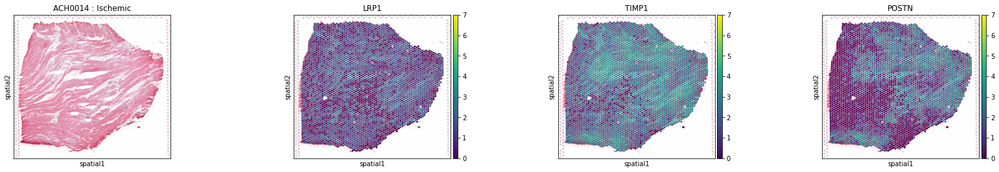

dataset_name: AKK001_157785.h5ad; 10X0027


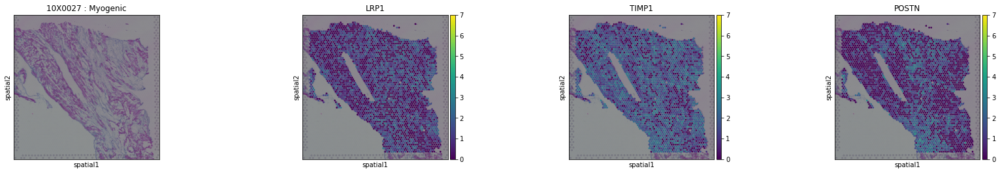

dataset_name: Visium_3_CK281.h5ad; ACH003


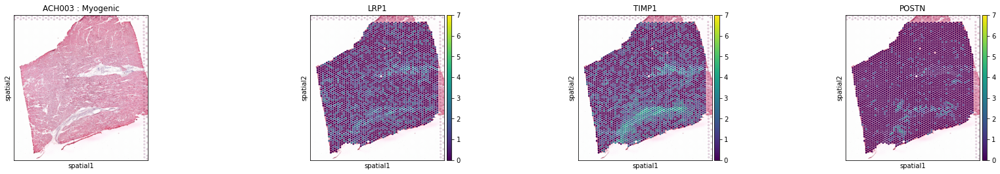

dataset_name: Visium_9_CK287.h5ad; ACH0012


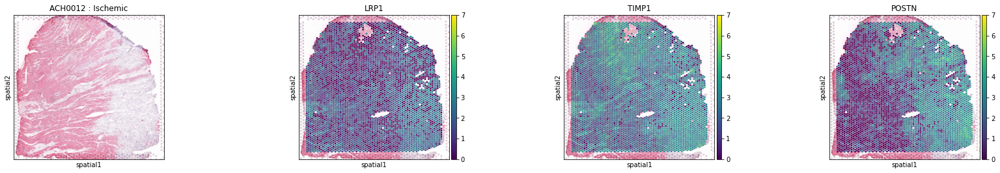

dataset_name: Visium_14_CK292.h5ad; ACH008


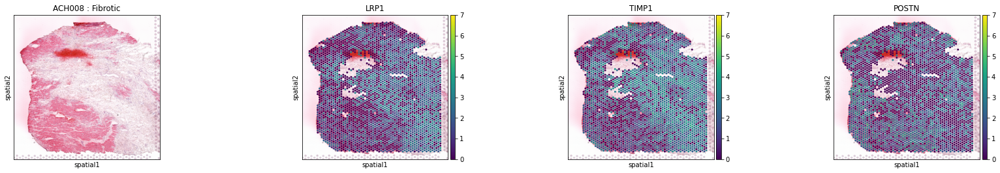

dataset_name: Visium_16_CK294.h5ad; ACH007


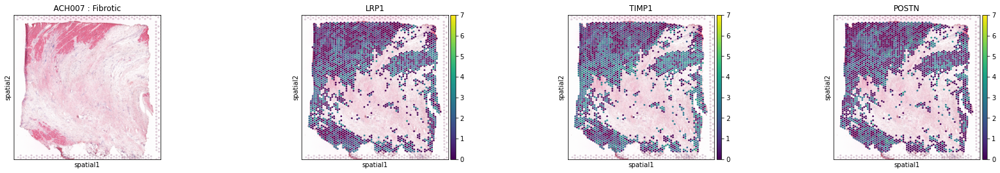

dataset_name: Visium_11_CK289.h5ad; ACH0010


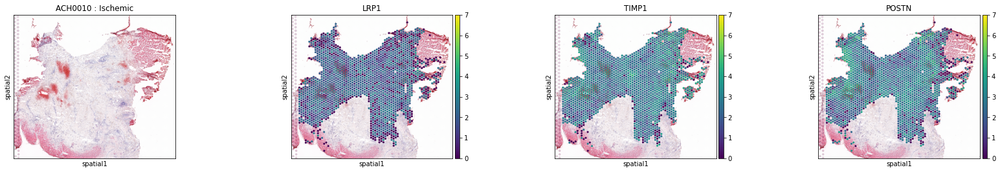

dataset_name: Visium_12_CK290.h5ad; ACH005


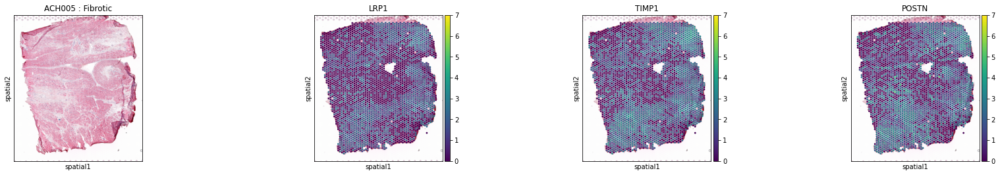

dataset_name: AKK003_157775.h5ad; 10X0018


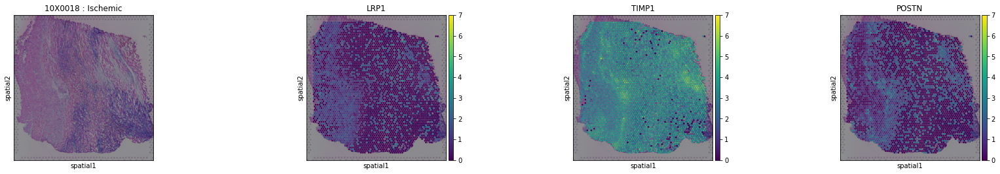

dataset_name: Visium_1_CK279.h5ad; ACH002


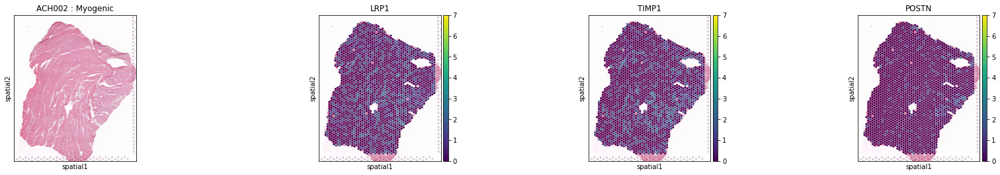

In [33]:
for dataset_name in dataset_names:
   sample_id = metadata.loc[dataset_name.replace('.h5ad', ''), 'hca_sample_id']
   patient_grup = metadata.loc[dataset_name.replace('.h5ad', ''), 'patient_group']
   
   print(f"dataset_name: {dataset_name}; {sample_id}")
   adata = load_prep_slide(data_dir, dataset_name, add_sample_name=True)

   genes_to_check = {"POSTN", "LRP1", "TIMP1"}
   genes_to_print = set(adata.var.index) & genes_to_check

   sc.pl.spatial(adata, color= [None] + list(genes_to_print), 
                       cmap='viridis', size=1.3, 
                       title=f"{sample_id} : {patient_grup}", 
                       save=f"{sample_id}_genes.pdf", vmin = 0, vmax = 7)

In [35]:
gex_data = []

for dataset_name in dataset_names:
   sample_id = metadata.loc[dataset_name.replace('.h5ad', ''), 'hca_sample_id']
   patient_grup = metadata.loc[dataset_name.replace('.h5ad', ''), 'patient_group']
   
   print(f"dataset_name: {dataset_name}; {sample_id}")
   adata = load_prep_slide(data_dir, dataset_name, add_sample_name=True)

   genes_to_check = {"POSTN", "LRP1", "TIMP1"}
   genes_to_print = set(adata.var.index) & genes_to_check

   gex_temp = pd.DataFrame(adata[:,list(genes_to_print)].X.todense())
   gex_temp.index = adata.obs.index.values
   gex_temp.columns = list(genes_to_print)
   gex_temp[["hca_sample_id"]] = sample_id

   gex_data.append(gex_temp)

gex_df = pd.concat(gex_data, ignore_index=True)
gex_df = pd.merge(gex_df, metadata, on='hca_sample_id', how='left')
gex_df.to_csv("results/gene_expression.csv")

dataset_name: Visium_2_CK280.h5ad; ACH0021
dataset_name: Visium_20_CK298.h5ad; ACH0015
dataset_name: Visium_6_CK284.h5ad; ACH0023
dataset_name: Visium_4_CK282.h5ad; ACH004
dataset_name: Visium_19_CK297.h5ad; ACH0013
dataset_name: Visium_13_CK291.h5ad; ACH006
dataset_name: Visium_17_CK295.h5ad; ACH0022
dataset_name: Visium_10_CK288.h5ad; ACH0024
dataset_name: AKK003_157777.h5ad; 10X0025
dataset_name: Visium_15_CK293.h5ad; ACH0016
dataset_name: Visium_8_CK286.h5ad; ACH0019
dataset_name: AKK002_157779.h5ad; 10X0017
dataset_name: AKK006_157771.h5ad; 10X001
dataset_name: AKK002_157781.h5ad; 10X0026
dataset_name: AKK004_157772.h5ad; 10X009
dataset_name: AKK002_157782.h5ad; 10X0020
dataset_name: Visium_18_CK296.h5ad; ACH0011
dataset_name: Visium_5_CK283.h5ad; ACH0028
dataset_name: Visium_7_CK285.h5ad; ACH0014
dataset_name: AKK001_157785.h5ad; 10X0027
dataset_name: Visium_3_CK281.h5ad; ACH003
dataset_name: Visium_9_CK287.h5ad; ACH0012
dataset_name: Visium_14_CK292.h5ad; ACH008
dataset_name: Vi

In [37]:
global_scores = []

for sample_name in list(lrdatas.keys()):
    g_dat = lrdatas[sample_name].var[["ligand", "receptor", "morans","mean"]].reset_index(drop=False)
    g_dat[["hca_sample_id"]] = sample_name
    global_scores.append(g_dat)

result_df = pd.concat(global_scores, ignore_index=True)
result_df = pd.merge(result_df, metadata, on='hca_sample_id', how='left')
result_df.to_csv("results/liana_scores.csv")

In [61]:
cosine_data = []

for dataset_name in list(lrdatas.keys()):
   lrdata = lrdatas[dataset_name]
   ints_to_check = {'TIMP1^POSTN', 'TIMP1^LRP1'}
   ints = set(lrdata.var.index) & ints_to_check

   int_temp = pd.DataFrame(lrdata[:,list(ints)].X.todense())
   int_temp.index = lrdata.obs.index.values
   int_temp.columns = list(lrdata.var.index.values)
   int_temp[["hca_sample_id"]] = dataset_name

   cosine_data.append(int_temp)

cosine_df = pd.concat(cosine_data, ignore_index=True)
cosine_df = cosine_df[['TIMP1^POSTN', 'TIMP1^LRP1', 'hca_sample_id']]
cosine_df = pd.merge(cosine_df, metadata, on='hca_sample_id', how='left')
cosine_df.to_csv("results/liana_scores_per_spot.csv")